# Code to create the plots for the poster
Try it out online with a Binder environement! 

Import all the packages you'll need

In [1]:
%%capture
%load_ext autoreload
%autoreload 2
from antarctic_plots import maps, fetch, regions, profile, utils

## Download and plot BedMap2 data

grd2cpt [ERROR]: Making a continuous cpt from a discrete cpt may give unexpected results!
gmtset [WARNING]: Representation of font type not recognized. Using default.
mapproject [WARNING]: For a UTM or TM projection, your region 1530000.0/2460000.0/430000.0/1000000.0 is too large to be in degrees and thus assumed to be in meters
mapproject [WARNING]: For a UTM or TM projection, your region 1530000.0/2460000.0/430000.0/1000000.0 is too large to be in degrees and thus assumed to be in meters
colorbar [WARNING]: For a UTM or TM projection, your region 1530000.0/2460000.0/430000.0/1000000.0 is too large to be in degrees and thus assumed to be in meters


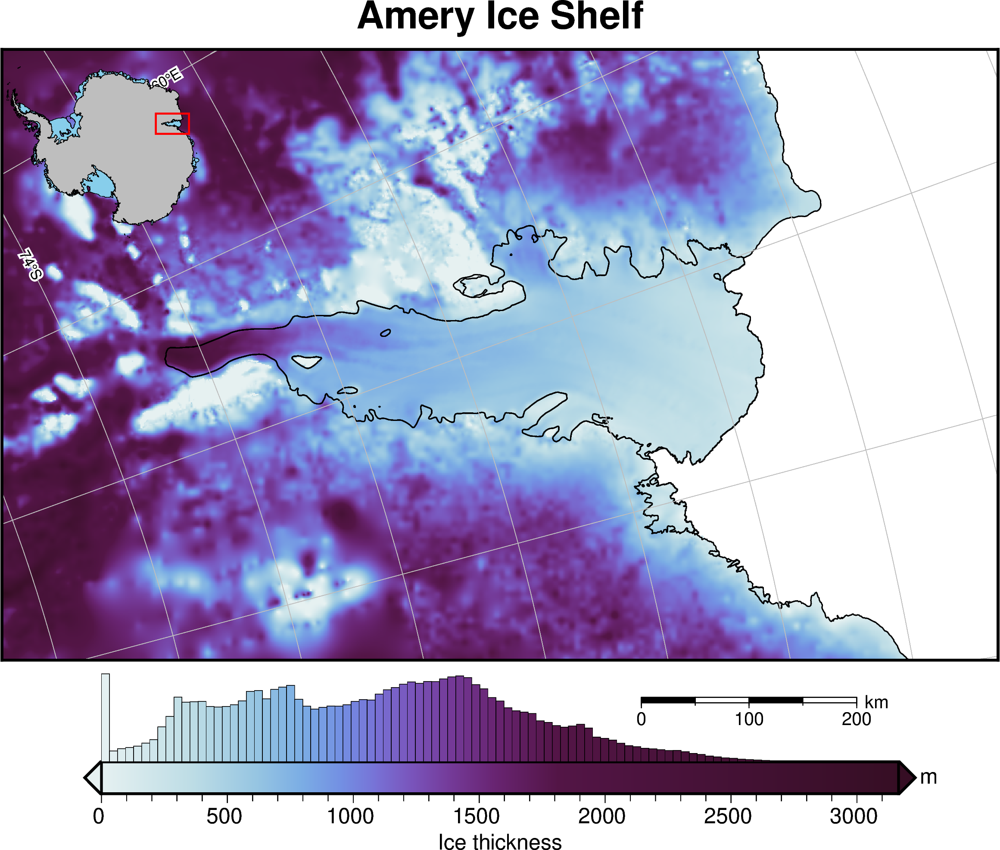

In [2]:
# download data
ice_thickness = fetch.bedmap2(
    layer="thickness",
    region=regions.amery_ice_shelf,
)

# plot map
fig = maps.plot_grd(
    ice_thickness,
    fig_height=12,  # set figure height
    cmap="dense",  # set the colormap
    grd2cpt=True,  # scale colormap limits to grid
    coast=True,  # plot grounding and coastlines
    title="Amery Ice Shelf",  # add title
    cbar_label="Ice thickness",  # add label
    cbar_unit="m",  # add units
    inset=True,  # add inset map
    inset_width=0.2,  # proportional width of inset
    scalebar=True,  # add scalebar
    scale_position="n.75/-.07",  # position of scalebar
    gridlines=True,  # add lat/lon gridlines
    x_spacing=10,  # longitude interval (deg)
    y_spacing=2,  # latitude interval (deg)
    hist=True,  # add a histogram
    hist_bin_num=100,  # number of bins
)

# display
fig.show()

In [ ]:
# save the figure
fig.savefig("poster_v2/amery_ice_shelf.png")

## Subplots

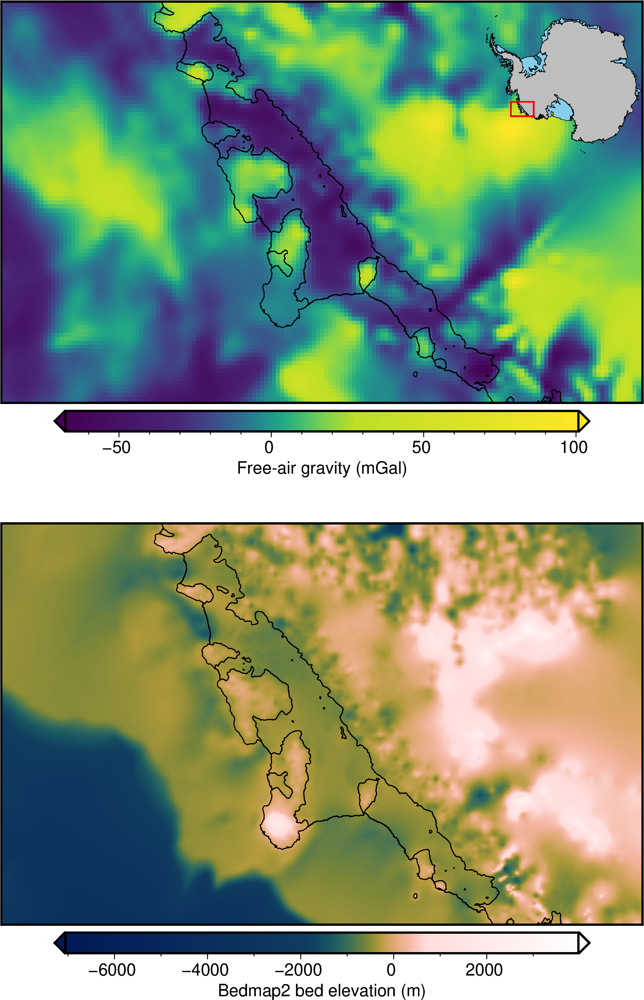

In [4]:
# define a region
region = (-1800e3, -1000e3, -1200e3, -700e3)

# download
bed = fetch.bedmap2(
    "bed",
    spacing=1e3,
)
gravity = fetch.gravity(
    version="antgg-update",
    anomaly_type="FA",
    spacing=5e3,
    region=region,
)

# plot
fig = maps.plot_grd(
    bed,
    fig_height=10,
    region=region,
    grd2cpt=True,
    cmap="batlowW",
    coast=True,
    cbar_label="Bedmap2 bed elevation (m)",
    grid_lines=True,
)

fig = maps.plot_grd(
    gravity,
    fig_height=10,
    region=region,
    grd2cpt=True,
    cmap="viridis",
    coast=True,
    cbar_label="Free-air gravity (mGal)",
    origin_shift="yshift",
    fig=fig,
    inset=True,
    inset_pos="TR",
    grid_lines=True,
)

# show
fig.show()

## Sample data along a profile
First we need to fetch the datasets to sample. By default the function will sample Bedmap2 layers for the cross section. We will provide out own datasets to show as data profiles.

In [7]:
# well plot both gravity data and geothermal heat flux data

gravity = fetch.gravity(
    version="antgg-update",
    anomaly_type="BA",
)

GHF = fetch.ghf(version="losing-ebbing-2021")

# add the data and properties to a dictionary
data = profile.make_data_dict(
    names=["Bouguer gravity", "Geothermal heat flux"],
    grids=[gravity, GHF],
    colors=["blue", "red"],
    axes=[0, 1],  # use seperate y axes for plotting
)

Next we need to define our profile location. We have 3 options for that.

* Option 1: use two sets of coordinates to define a line
Coordinates are in meters east and north; EPSG3031 Polar Stereographic Projection
If you don't know which coordinates to use, click on a point on the map and copy and paste the output coordinates to variables `a` and `b`.

* Option 2: use a shapefile as the path

* Option 3: click on an interactive map to create a line

In [8]:
# option 1
# coordinates in meters east and north; EPSG3031 Polar Stereographic Projection
a = [437248.0000000149, -902144.0000000305]
b = [121855.99999999959, -1378303.9999999988]
# click on the below map and copy the output coordinates.

# option 2
# provide your own shapefile, or use fetch to retrieve one
shapefile = fetch.sample_shp("Disco_deep_transect")

# option 3
# use the "Draw a polyline" button on the below map to create a line.
lines = profile.draw_lines()

Label(value='')

Map(center=[-90.0, 0.0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out…

In [9]:
# for option 3, we need to extract the clicked vertices
# extract the vertices of the line
line = utils.shapes_to_df(lines)
line

,lon,lat,shape_num,x,y
0,-77.494800,-70.339680,0,-2.105344e+06,4.669440e+05
1,-73.930116,-71.099999,0,-1.990656e+06,5.734400e+05
2,-69.527720,-72.034850,0,-1.843200e+06,6.881280e+05
3,-64.420821,-72.494677,0,-1.728512e+06,8.273920e+05
4,-59.872940,-73.290454,0,-1.581056e+06,9.175040e+05
5,-55.741963,-73.239557,0,-1.515520e+06,1.032192e+06


Now we can make the cross section plot!

gmtset [WARNING]: Representation of font type not recognized. Using default.


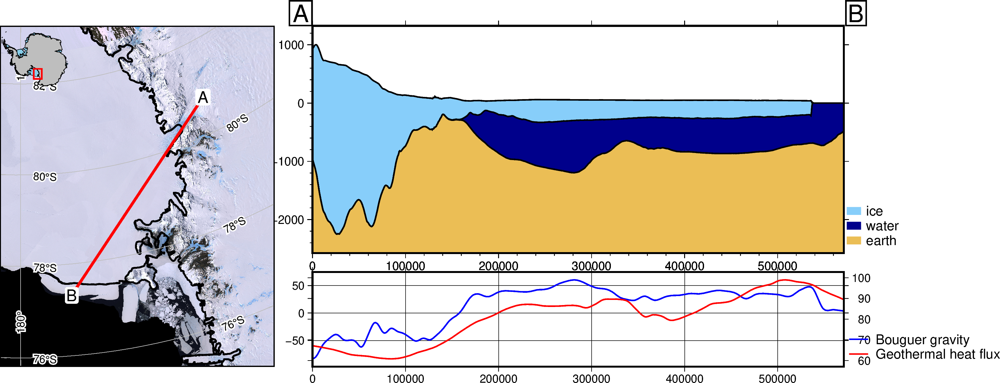

In [10]:
# option 1
# note these can take a minute or two to plot since the imagery file is quite large.
# add `map_background=fetch.bedmap2("surface"),` for a faster plot
fig, df_layers, df_data = profile.plot_profile(
    method="points",
    start=a,
    stop=b,
    data_dict=data,
    add_map=True,
    # map_background=bed,
)
fig.show()

gmtset [WARNING]: Representation of font type not recognized. Using default.


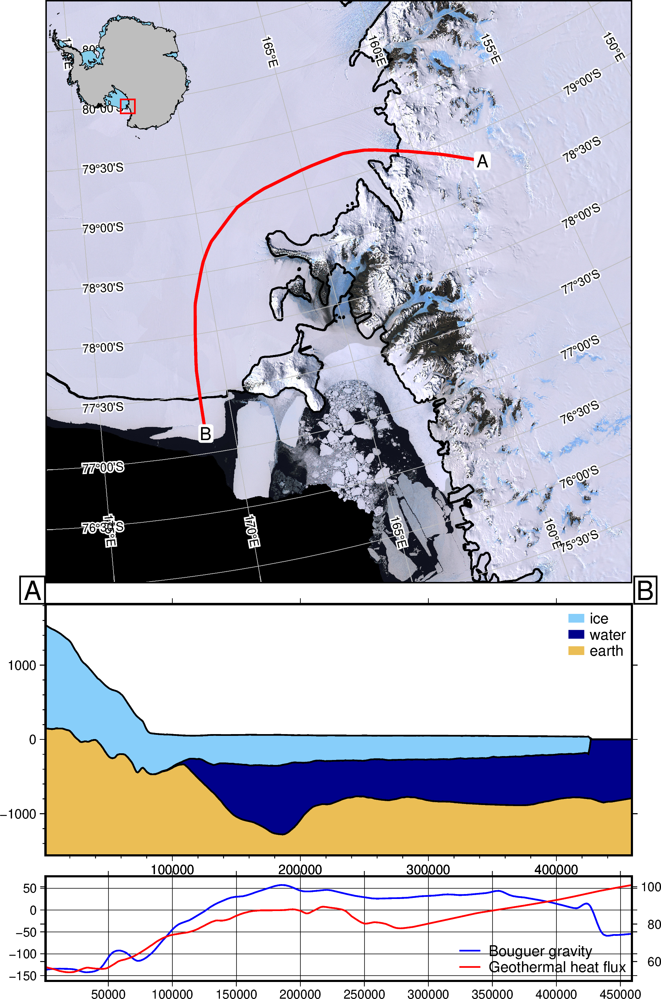

In [11]:
# option 2
fig, df_layers, df_data = profile.plot_profile(
    method="shapefile",
    shapefile=shapefile,
    data_dict=data,
    add_map=True,
    subplot_orientation="vertical",
    # map_background=bed,
    data_legend_loc="JBR+jBR+o0c",
    layers_legend_loc="JTR+jTR+o0c",
)
fig.show()

In [12]:
# save the figure
# fig.savefig("poster_v2/map_and_data_profile.png")

gmtset [WARNING]: Representation of font type not recognized. Using default.


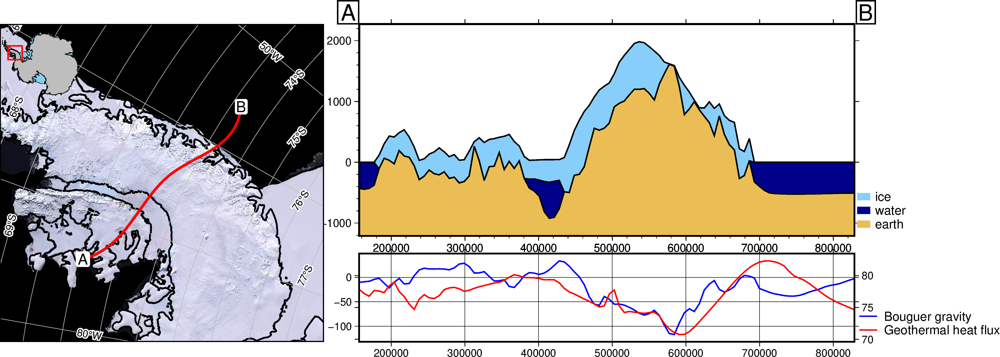

In [13]:
# option 3
fig, df_layers, df_data = profile.plot_profile(
    method="polyline",
    polyline=line,
    num=100,  # interpolate between clicked points
    data_dict=data,
    add_map=True,
    # map_background=bed,
)
fig.show()

Use the below for a quick and simple cross section

In [2]:
lines = profile.draw_lines()

Label(value='')

Map(center=[-90.0, 0.0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out…

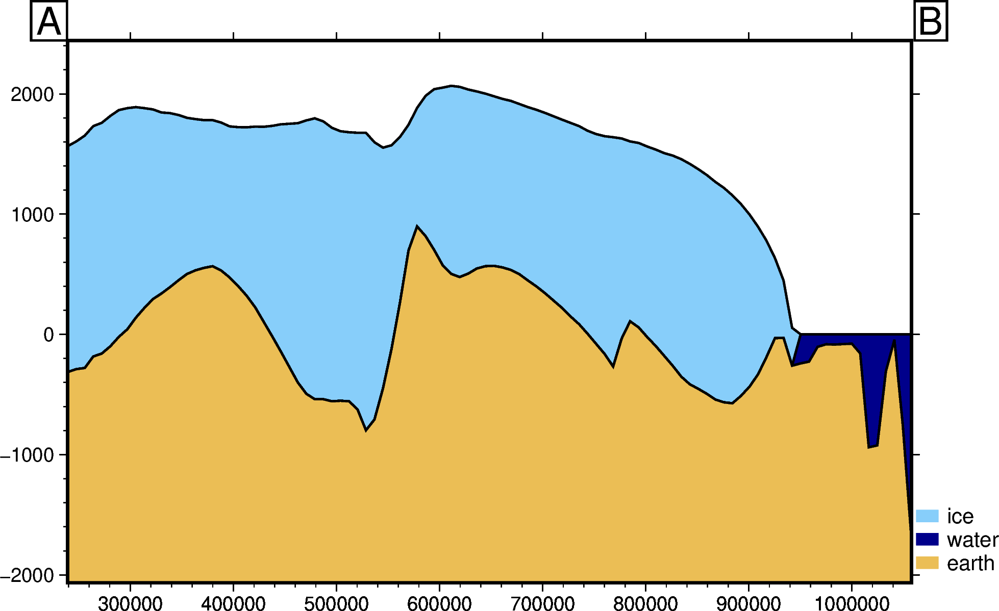

In [5]:
# line = utils.shapes_to_df(lines)
# fig, _, _ = profile.plot_profile(
#     method="polyline",
#     polyline=line,
#     num=100,
#     # add_map=True
# )
# fig.show()

## Compare grids

In [2]:
# define a region
region = regions.pine_island_glacier

# download
bedmachine = fetch.bedmachine("bed", spacing=1e3, region=region)
bedmap = fetch.bedmap2("bed", spacing=1e3, region=region)

grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


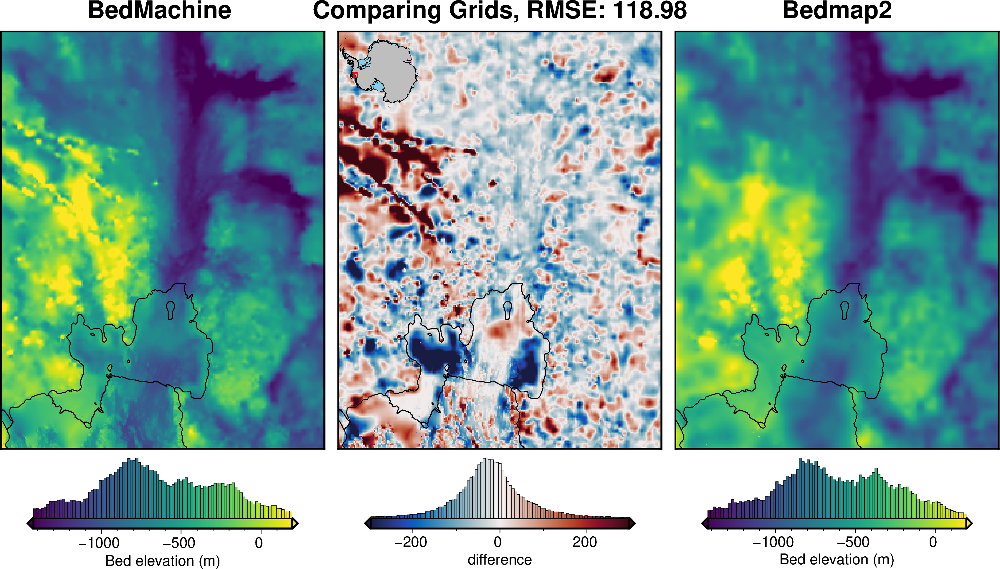

In [3]:
# compare
dif, grid1, grid2 = utils.grd_compare(
    bedmachine,
    bedmap,
    plot=True,
    coast=True,
    robust=True,
    grid1_name="BedMachine ",
    grid2_name="Bedmap2",
    cbar_label="Bed elevation (m)",
    hist=True,
)

## Extract trend from grid

/home/matt/mambaforge/envs/antarctic_plots_binder/lib/python3.11/site-packages/antarctic_plots/utils.py:729: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fit"] = trend.predict((df[coords[0]], df[coords[1]]))
/home/matt/mambaforge/envs/antarctic_plots_binder/lib/python3.11/site-packages/antarctic_plots/utils.py:732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["detrend"] = df[coords[2]] - df.fit


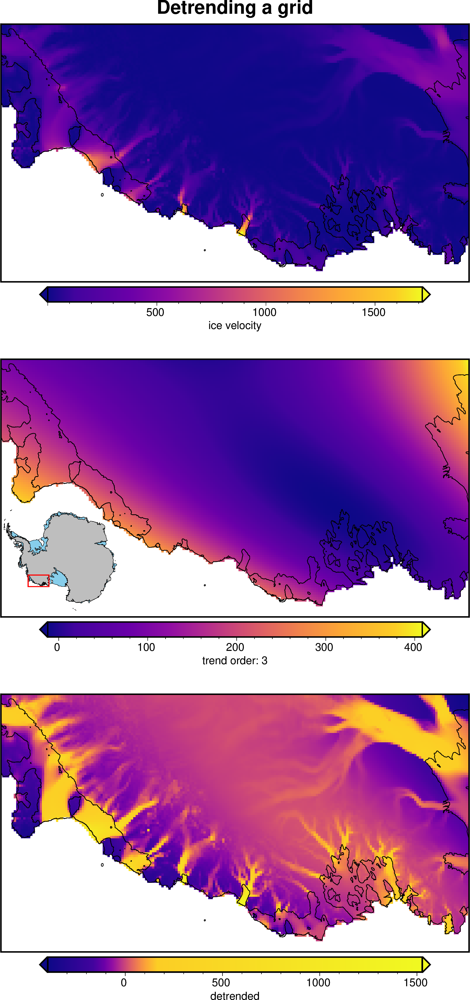

In [4]:
# download
ice_velocity = fetch.ice_vel(region=regions.marie_byrd_land, spacing=5e3)

# extract and detrend
fit, detrend = utils.grd_trend(ice_velocity, deg=3)

# plot
fig = maps.plot_grd(
    detrend,
    fig_height=10,
    cmap="plasma",
    grd2cpt=True,
    coast=True,
    cbar_label="detrended",
)

fig = maps.plot_grd(
    fit,
    fig=fig,
    fig_height=10,
    cmap="plasma",
    grd2cpt=True,
    coast=True,
    cbar_label="trend order: 3",
    inset=True,
    inset_pos="BL",
    origin_shift="yshift",
)

fig = maps.plot_grd(
    ice_velocity,
    fig=fig,
    fig_height=10,
    cmap="plasma",
    grd2cpt=True,
    coast=True,
    cbar_label="ice velocity",
    title="Detrending a grid",
    origin_shift="yshift",
)

fig.show()

## Mask grid with shapefile

In [5]:
# fetch a grid
grid = fetch.bedmap2(layer="surface", spacing=5e3)

# fetch a shapefile
shape = fetch.groundingline(version="depoorter-2013")

import pyogrio

# get just the grounding line
gdf = pyogrio.read_dataframe(shape)
groundingline = gdf[gdf.Id_text == "Grounded ice or land"]

grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


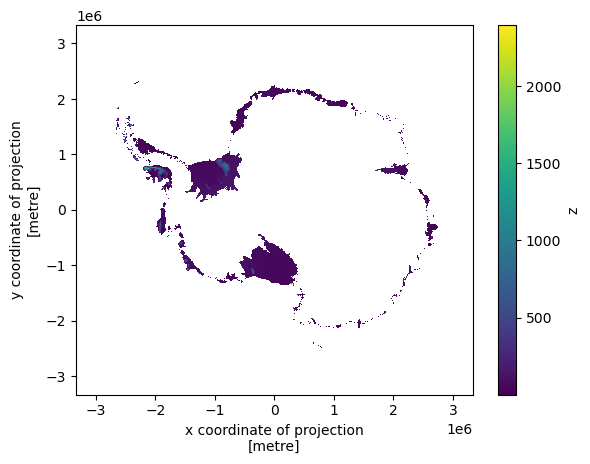

In [6]:
# mask the inside region
masked_inside = utils.mask_from_shp(shapefile=groundingline, xr_grid=grid, masked=True)
masked_inside.plot()

## Use with normal PyGMT commands

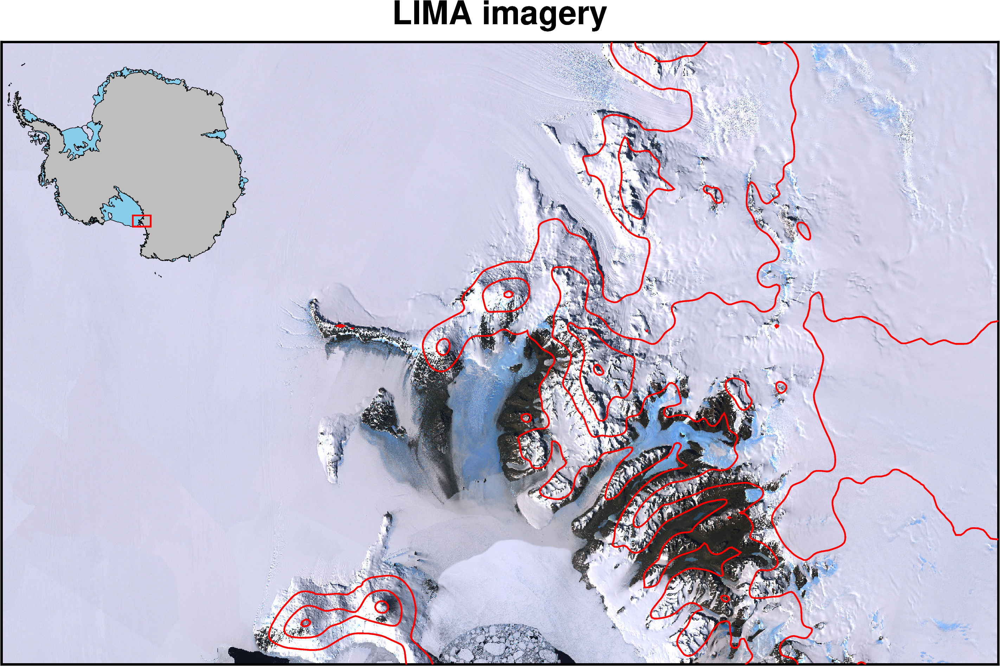

In [13]:
imagery = fetch.imagery()

region = (150e3, 550e3, -1350e3, -1100e3)
# region = regions.minna_bluff

fig = maps.plot_grd(
    imagery,
    region=region,
    image=True,
    inset=True,
    title="LIMA imagery",
    grid_lines=True,
    x_annots=10,  # plot 10 degree longitude lines
    y_annots=2,  # plot 2 degree latitude lines
)

# add surface elevation contours
surface = fetch.bedmap2(layer="surface", region=region, spacing=1e3)
fig.grdcontour(grid=surface, interval=750, pen="thick,red")

fig.show()

## Show available regions

In [10]:
region_dict = regions.get_regions()
region_dict

{'antarctica': (-2800000.0, 2800000.0, -2800000.0, 2800000.0),
 'west_antarctica': (-2740000.0, 570000.0, -2150000.0, 1670000.0),
 'east_antarctica': (-840000.0, 2880000.0, -2400000.0, 2600000.0),
 'antarctic_peninsula': (-2600000.0, -1200000.0, 170000.0, 1800000.0),
 'marie_byrd_land': (-1500000.0, -500000.0, -1350000.0, -800000.0),
 'victoria_land': (100000.0, 1000000.0, -2200000.0, -1000000.0),
 'roosevelt_island': (-480000.0, -240000.0, -1220000.0, -980000.0),
 'ross_island': (210000.0, 360000.0, -1400000.0, -1250000.0),
 'minna_bluff': (210000.0, 390000.0, -1310000.0, -1120000.0),
 'mcmurdo_dry_valleys': (320000.0, 480000.0, -1400000.0, -1220000.0),
 'siple_coast': (-700000.0, 30000.0, -1110000.0, -450000.0),
 'crary_ice_rise': (-330000.0, -40000.0, -830000.0, -480000.0),
 'siple_dome': (-630000.0, -270000.0, -970000.0, -630000.0),
 'ross_ice_shelf': (-680000.0, 470000.0, -1420000.0, -310000.0),
 'larsen_ice_shelf': (-2430000.0, -1920000.0, 900000.0, 1400000.0),
 'ronne_filchner_i

In [11]:
%%capture
# remove a few of the regions to clean up the plot
remove = [
    "antarctica",
    "west_antarctica",
    "east_antarctica",
    'minna_bluff',
    'siple_dome',
    'roosevelt_island',
    'crary_ice_rise',
    ]
[region_dict.pop(key) for key in remove]

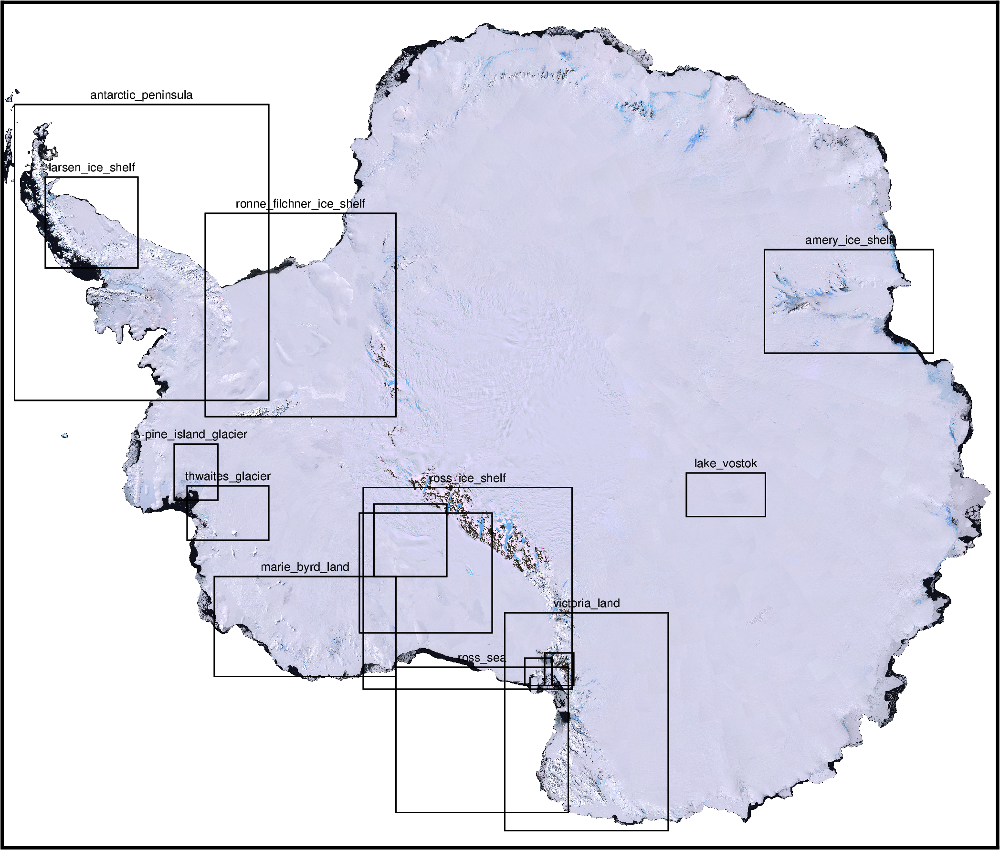

In [12]:
from statistics import mean

fig = maps.plot_grd(
    grid=fetch.imagery(),
    image=True,
    plot_region=regions.antarctica,
)

for k, v in region_dict.items():
    maps.add_box(fig, v, pen=".6p,black")
    if k not in [
        "mcmurdo_dry_valleys",
        "siple_coast",
        "ross_island",
        "kamb_ice_stream",
    ]:
        fig.text(
            x=mean([v[1], v[0]]),
            y=v[3],
            text=k,
            justify="CB",
            offset="0/.1",
            no_clip=True,
            font="6p,Helvetica,black",
        )

# save figure
# fig.savefig("regions_plot.png")

fig.show()